In [1]:
import sys
import itertools

import numpy as np
import pandas as pd
import scipy.signal
from scipy.signal import savgol_filter
from scipy.stats import zscore
from tqdm import tqdm

import neuroseries as nts


import time
import matplotlib.pyplot as plt

import seaborn as sns 
import bk.load
import bk.compute
import bk.plot
import bk.signal

import os

plt.rcParams['svg.fonttype'] = 'none'
plt.style.use('ggplot')

In [2]:
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go

In [3]:
def isi(timestamps,nbins = 200):
    inter_event = np.diff(timestamps.values)
    inter_event = inter_event[inter_event<10_000]
    h , b = np.histogram(inter_event,nbins)
    return b,h 

In [4]:
def plot_isi(timestamps,nbins = 200):
    b,h = isi(timestamps.as_units('ms').index,nbins)
    plt.bar(b[1::],h,b[1]-b[0])
    

In [8]:
def plot_cross_corr(gamma,max_y = 100,name = 'NoName'):
    binSize = 0.01
    a = [gamma['left']['peaks'],gamma['right']['peaks'],gamma['Hpc']['peaks']]
    t,c = bk.compute.crosscorrelogram(a,binSize,[-0.5,0.5])
    for i in range(3):
        c[np.argmax(c[:,i,i]),i,i] = 0


    fig,ax = plt.subplots(3,3)

    for i in range(3):
        for j in range(3):
            ax[i,j].bar(t,c[:,i,j],binSize)
            ax[i,j].set_ylim(0,max_y)
    plt.suptitle(name)
    plt.tight_layout()

In [6]:
def triggered_average(signal,timestamps,win_size,fs = 1250):
    n_samples = int(np.ceil(1250*win_size/2))
    averaged = np.zeros((len(timestamps),n_samples*2))
    for i,t in tqdm(enumerate(timestamps.values),total = len(timestamps)):
        peak_i = np.where(signal.index.values == t)[0][0]
        trig = signal.iloc[peak_i-n_samples:peak_i+n_samples]
        if len(trig) == n_samples*2: averaged[i,:] = trig
    averaged = averaged[np.sum(averaged,1) !=0]
    
    t = np.linspace(-n_samples/1250,n_samples/1250,n_samples*2)
    return t,averaged

In [7]:
def detect_gamma(lfp, threshold=2, max_inter=20, min_duration=10, max_duration=500):
    # This function aim at detecting gamma burst. It will return nts.IntervalSet with beg and end of gamma burst.
    lfp_filt = bk.signal.passband(lfp, 60, 80)  # filter the signal
    env = bk.signal.enveloppe(lfp_filt)  # enveloppe of signal
    z_env = bk.compute.nts_zscore(env)  # zscore enveloppe of signal

    thresholded = z_env.values > threshold
    gamma_intervals = bk.compute.toIntervals(lfp_filt.index.values, thresholded)

    # Cleaning intervals according to parameters
    gamma_intervals = gamma_intervals.merge_close_intervals(max_inter,'ms')
    gamma_intervals = gamma_intervals.iloc[gamma_intervals.duration('ms') < max_duration]
    gamma_intervals = gamma_intervals.drop_short_intervals(min_duration, 'ms').reset_index(drop=True)
    
    gamma_peaks = []
    for gamma in tqdm(gamma_intervals.iloc,total = len(gamma_intervals)):        
        peak = lfp_filt.loc[gamma.start:gamma.end].index.values[np.argmax(lfp_filt.loc[gamma.start:gamma.end])]
        gamma_peaks.append(peak)
    gamma_peaks = nts.Ts(np.array(gamma_peaks))

    return gamma_intervals, gamma_peaks

In [8]:
def main(base_folder, local_path, *args, **kwargs):
    bk.load.current_session_linux(base_folder,local_path)
    states = bk.load.states(new_names = True)
    sides = ['left', 'right']

    gamma = {}
    for state in ['NREM', 'REM']:

        lfp = {}
        for side in sides:
            lfp.update({side: bk.load.lfp_in_intervals(
                bk.load.bla_channels()[side], states[state])})
        lfp.update({'Hpc': bk.load.lfp_in_intervals(
            bk.load.ripple_channel(), states[state])})

        gamma[state] = {}
        for chan in lfp:
            if lfp[chan] is None: continue
            intervals, peaks = detect_gamma(lfp[chan], 2, 30, 30, 200)
            gamma[state][chan] = {'intervals': intervals,
                                  'peaks': peaks}

    os.makedirs('Analysis/Gamma', exist_ok=True)
    try:
        os.remove('gamma_intervals_rem.npy')
        os.remove('gamma_intervals_nrem.npy')
    except:
        print('Could not delete old gamma files')
    
    np.save('Analysis/Gamma/gamma_intervals.npy', gamma, allow_pickle=True)

    return gamma

In [9]:
def load_gamma():
    bk.load.analysis('Gamma/Gamma_intervals')

In [24]:
main('/mnt/electrophy/Gabrielle/GG-Dataset-Light/','Rat08/Rat08-20130708')

Rat : 8 on day : 1
Working with session Rat08-20130708 @ /mnt/electrophy/Gabrielle/GG-Dataset-Light/Rat08/Rat08-20130708


100%|██████████| 929/929 [00:03<00:00, 297.34it/s]

Could not delete old gamma files


TypeError: pandas.core.series.Series.__init__() got multiple values for keyword argument 'index'

In [9]:
batch = bk.load.batch(main)

  5%|▍         | 3/61 [14:13<4:19:42, 268.66s/it]

Loading Data from Rat08-20130711
Rat : 8 on day : 4
Working with session Rat08-20130711 @ /mnt/electrophy/Gabrielle/GG-Dataset-Light/Rat08/Rat08-20130711


In [9]:
gamma = main('/mnt/electrophy/Gabrielle/GG-Dataset-Light/','Rat08/Rat08-20130713')

Rat : 8 on day : 6
Working with session Rat08-20130713 @ /mnt/electrophy/Gabrielle/GG-Dataset-Light/Rat08/Rat08-20130713


100%|██████████| 1381/1381 [00:05<00:00, 266.06it/s]


Could not delete old gamma files


In [15]:
# gamma_intervals, gamma_peaks = bk.load.analysis(
#     f'Gamma/gamma_intervals_nrem.npy')
plot_cross_corr(gamma,max_y=100)

NameError: name 'gamma' is not defined

In [49]:
bk.load.current_session_linux()
neurons, metadata = bk.load.spikes()

# gamma_intervals, gamma_peaks = bk.load.analysis(
#     f'Gamma/gamma_intervals_nrem.npy')
actmat = bk.compute.binSpikes([gamma_peaks['left']], binSize=0.0025, fast=True, as_Tsd=True)
f, sxx = scipy.signal.welch(actmat.values[:, 0], 1/0.0025, nperseg = 1000, noverlap = 750)


Rat : 8 on day : 6
Working with session Rat08-20130713 @ /mnt/electrophy/Gabrielle/GG-Dataset-Light/Rat08/Rat08-20130713
Data already saved in Numpy format, loading them from here:
Rat08-20130713-neurons.npy
Rat08-20130713-metadata.npy


In [51]:
plt.plot(f,sxx)

In [26]:
lfp_filt = {}
for side in lfp:
    lfp_filt.update({side:bk.signal.passband(lfp[side],60,80)})

In [33]:
# Code for generating CrossCorrelograms of gamma burst 
# gamma_intervals,gamma_peak = bk.load.analysis(f'Gamma/gamma_intervals_rem.npy')





In [27]:
%matplotlib qt
fig,ax = plt.subplots(2,3)

for i,side in enumerate(['left','right','Hpc']):
    t,averaged = triggered_average(lfp[side],gamma['left']['peaks'].index,.5)
    t,averaged_filt = triggered_average(lfp_filt[side],gamma['left']['peaks'].index,0.5)

    bk.plot.confidence_intervals(t,averaged,'orange',ax[0,i])
    bk.plot.confidence_intervals(t,averaged_filt,'orange',ax[1,i])
    ax[0,i].set_ylim(-50,150)
    ax[1,i].set_ylim(-75,75)
    ax[0,i].set_title(side)

plt.suptitle('Gamma Bursed Triggered Averaged')
plt.tight_layout()
plt.show()


100%|██████████| 1354/1354 [00:03<00:00, 385.03it/s]


In [62]:
def plotly_intervals(fig,intervals,time_units = 's',row = None,col = None):
    for s,e in intervals.as_units(time_units).iloc:
        fig.add_vrect(x0 = s, x1 = e, line_width = 0, fillcolor = 'red',opacity = 0.2,row = row,col = col)

In [63]:
fig = make_subplots(3, 1, shared_xaxes='all',shared_yaxes='all')
for i, chan in enumerate(gamma):
    fig.add_trace(go.Scatter(x=lfp[chan].as_units('s')[6000:6200].index,
                            y=lfp[chan].as_units('s')[6000:6200].values,
                            mode = 'lines',
                            line = {'color':'SkyBlue'},
                            name = f'LFP {chan}'), i+1, 1)
    fig.add_trace(go.Scatter(x=lfp_filt[chan].as_units('s')[6000:6200].index,
                            y=lfp_filt[chan].as_units('s')[6000:6200].values*5,
                            line = {'color':'tomato'},
                            name = f'Filt LFP {chan}',
                            opacity = 0.5), i+1, 1)
    plotly_intervals(fig,gamma[chan]['intervals'].intersect(nts.IntervalSet(6000,6200,'s')),'s',i+1,1)

    
fig.show()
fig.write_html('test.html')

In [41]:
%matplotlib qt
fig, axis = plt.subplots(3,1,sharex=True,sharey=True)

for ax,chan in zip(axis,gamma):
    plt.sca(ax)
    ax.plot(lfp[chan].as_units('s')[6000:6200],alpha = 0.8)
    ax.plot(lfp_filt[chan].as_units('s')[6000:6200].index.values,lfp_filt[chan].as_units('s')[6000:6200].values*10,alpha = 0.3)
    bk.plot.intervals(gamma[chan]['intervals'].intersect(nts.IntervalSet(6000,6200,'s')))
    plt.title(chan)
plt.tight_layout()

In [45]:
# for side in ['left','right','Hpc']:
env = bk.signal.enveloppe(lfp_filt[side])
# plt.plot(bk.compute.nts_zscore(lfp_filt['Hpc']).as_units('s')[6000:6200])
plt.plot(bk.compute.nts_zscore(env).as_units('s')[6000:6200])
plt.plot(bk.compute.nts_zscore(lfp['left']).as_units('s')[6000:6200]-5)

    # f,Sxx = scipy.signal.welch(env.values,1250,nperseg=10000,noverlap=7500)

In [5]:
# Probably deprecated because wrong and slow

# # def main(base_folder,local_path,*args,**kwargs):

# state = 'sws'

# bk.load.current_session_linux()
# states = bk.load.states()
# sides = ['left','right']

# lfp = {}
# lfp_filt = {}
# lfp_filt_zscore = {}
# for side in sides:
#     lfp.update({side:bk.load.lfp_in_intervals(bk.load.bla_channels()[side],states[state])})
#     lfp_filt.update({side:bk.signal.passband(lfp[side],60,80)})
#     # lfp_filt_zscore.update({side:bk.compute.nts_zscore(lfp_filt[side])})
# lfp.update({'Hpc':bk.load.lfp_in_intervals(bk.load.ripple_channel(),states[state])})
# lfp_filt.update({'Hpc':bk.signal.passband(lfp['Hpc'],60,80)})

# gamma_burst = {}
# for chan in lfp:
#     env = bk.signal.enveloppe(lfp_filt[chan])
#     env_zscore = bk.compute.nts_zscore(env)
#     v = env_zscore.values > 2

#     # env = bk.signal.enveloppe(lfp_filt_zscore[chan])
#     # v = env.values > 2
#     gamma_burst.update({chan:bk.compute.toIntervals(lfp_filt[chan].index.values,v)})

# for chan in lfp:
#     gamma_burst[chan] = gamma_burst[chan].iloc[gamma_burst[chan].duration('s')<1]
#     gamma_burst[chan] = gamma_burst[chan].drop_short_intervals(1,'ms').reset_index(drop = True)

# gamma_peak = {}
# for chan in lfp:
#     print(chan)
#     gamma_peak.update({chan:nts.Ts(np.mean([gamma_burst[chan].start,gamma_burst[chan].end],0))})

# binSize = 0.01
# a = [gamma_peak['left'],gamma_peak['right'],gamma_peak['Hpc']]
# t,c = bk.compute.crosscorrelogram(a,binSize,[-0.5,0.5])
# for i in range(3):
#     c[np.argmax(c[:,i,i]),i,i] = 0

# # os.makedirs('Analysis/Gamma',exist_ok=True)
# # np.save('Analysis/Gamma/gamma_intervals_nrem.npy',[gamma_burst,gamma_peak],allow_pickle=True)


Rat : 8 on day : 6
Working with session Rat08-20130713 @ /mnt/electrophy/Gabrielle/GG-Dataset-Light/Rat08/Rat08-20130713
left
right
Hpc
You are using 0.01 ms bins with the function fast off. Consider using "Fast = True" in order to speed up the computations


100%|██████████| 3/3 [00:00<00:00, 27.77it/s]


In [16]:

bk.load.current_session_linux()
states = bk.load.states()
lfp = bk.load.lfp_in_intervals(bk.load.bla_channels()['left'],states['Rem'])
gamma_bouts = bk.signal.power_bouts(lfp, 60, 80, 1.5)
gamma_bouts.merge_close_intervals(10,'ms')
gamma_bouts = gamma_bouts.drop_short_intervals(10,'ms').reset_index(drop =True)


Rat : 8 on day : 6
Working with session Rat08-20130713 @ /mnt/electrophy/Gabrielle/GG-Dataset-Light/Rat08/Rat08-20130713


In [18]:
%matplotlib qt
plt.plot(lfp.as_units('s'))
bk.plot.intervals(gamma_bouts)
plt.xlim(6000,6200)

(6000.0, 6200.0)

In [19]:
%matplotlib qt

In [11]:
fig, axis = plt.subplots(3,1,sharex=True,sharey=True)

for ax,chan in zip(axis,gamma_burst):
    plt.sca(ax)
    ax.plot(lfp[chan].as_units('s')[6000:6200],alpha = 0.8)
    ax.plot(lfp_filt[chan].as_units('s')[6000:6200].index.values,lfp_filt[chan].as_units('s')[6000:6200].values)
    bk.plot.intervals(gamma_burst[chan].intersect(nts.IntervalSet(6000,6200,'s')))
    plt.title(chan)
plt.tight_layout()

NameError: name 'gamma_burst' is not defined

In [12]:
bk.load.batch(main)

 10%|▉         | 6/61 [03:26<32:41, 35.67s/it]

Loading Data from Rat08-20130715
Rat : 8 on day : 7
Working with session Rat08-20130715 @ /mnt/electrophy/Gabrielle/GG-Dataset-Light/Rat08/Rat08-20130715


In [7]:
a = [gamma_burst[side].duration('s') for side in ['left','right','Hpc']]

In [8]:
d = {'left':gamma_burst['left'].duration('s'),
'right':gamma_burst['right'].duration('s'),
'Hpc':gamma_burst['Hpc'].duration('s')}

In [67]:
df = pd.DataFrame(dict([ (k,pd.Series(v)) for k,v in d.items() ]))

In [68]:
# fig, ax = plt.subplots(3,1,dpi = 90,sharex=True)
# for i,chan in enumerate(lfp):
#     ax[i].plot(lfp[chan],'grey',alpha = 0.8)
#     ax[i].plot(lfp_filt[chan],'r')
#     plt.sca(ax[i])
#     bk.plot.intervals(gamma_burst[chan],time_units='us')


In [89]:
plt.figure(dpi = 200)
sns.violinplot(data = df)
plt.title(f'Gamma Burst Length NREM {bk.load.session} ')

Text(0.5, 1.0, 'Gamma Burst Length NREM Rat08-20130713 ')

In [74]:
gamma_burst['left'].duration('ms')

array([23.2, 68.8, 18.4, ..., 58.4, 26.4, 35.2])

In [87]:
for side in ['left','right','Hpc']:
    print(gamma_burst[side].duration('ms').mean())

31.03886222071767
31.153415011780545
29.924793216990455


# Averaged Gamma burst shape : 
We just defined gamma burst intervals, now we can take the peak of each gamma burst and average the LFP. This will give us the shape of gamma burst in the BLA 

In [21]:
bk.load.current_session_linux()
neurons, metadata = bk.load.spikes()
metadata = bk.load.metadata_with_side(metadata)
states = bk.load.states()


for state in ['rem','nrem']:
    gamma_intervals,gamma_peaks = bk.load.analysis(f'Gamma/gamma_intervals_{state}.npy')

    no_gamma_intervals = {}
    for side in ['left','right']:
        if state == 'rem':
            no_gamma_intervals.update({side:states['Rem'].set_diff(gamma_intervals[side])})
        else:
            no_gamma_intervals.update({side:states['sws'].set_diff(gamma_intervals[side])})

    gamma_lfp = bk.load.lfp_in_intervals(bk.load.bla_channels()['right'],gamma_intervals['right'])
    no_gamma_lfp = bk.load.lfp_in_intervals(bk.load.bla_channels()['right'],no_gamma_intervals['right'])

    f,gamma_Sxx = scipy.signal.welch(gamma_lfp.values,1250,nperseg=5000,noverlap=2500)
    f,no_gamma_Sxx = scipy.signal.welch(no_gamma_lfp.values,1250,nperseg=5000,noverlap=2500)

    plt.figure()
    plt.plot(f,np.log(gamma_Sxx))
    plt.plot(f,np.log(no_gamma_Sxx))
    plt.xlim(0,100)
    plt.title(state)


    chan = bk.load.bla_channels()['right']
    filt_gamma_bursts = np.empty(500)
    for inter in tqdm(gamma_intervals['right'].iloc):
        inter = nts.IntervalSet(inter.start,inter.end)
        start = inter.as_units('s').start.values
        end = inter.as_units('s').end.values
        
        lfp = bk.load.lfp(chan,np.floor(start)-0.5,np.ceil(end)+0.5)
        lfp_filt = bk.signal.passband(lfp,60,80)
        lfp_filt_short = lfp_filt.restrict(inter)
        peak = lfp_filt_short.index[np.argmax(lfp_filt_short.values)]
        peak = np.where(lfp.index.values == peak)[0][0]
        filt_gamma_burst = lfp_filt.iloc[peak-250:peak+250]
        filt_gamma_bursts = np.vstack((filt_gamma_bursts,filt_gamma_burst))

    filt_gamma_bursts = filt_gamma_bursts[1:]

    t = np.linspace(-200,+200,500)
    plt.figure()
    plt.plot(t,np.mean(filt_gamma_bursts,0))
    plt.title(state)

Rat : 8 on day : 6
Working with session Rat08-20130713 @ /mnt/electrophy/Gabrielle/GG-Dataset-Light/Rat08/Rat08-20130713
Data already saved in Numpy format, loading them from here:
Rat08-20130713-neurons.npy
Rat08-20130713-metadata.npy


2971it [02:00, 24.62it/s]


# Firing rates during and outside gamma burst events

In [1]:
%run imports

In [25]:
def plot_fr_gamma(base_folder,local_path,*args,**kwargs):
    bk.load.current_session_linux(base_folder = base_folder,local_path=local_path)
    neurons, metadata = bk.load.spikes()
    states = bk.load.states(True)
    metadata = bk.load.metadata_with_side(metadata)
    gamma = bk.load.analysis('Gamma/gamma_intervals')


    fr_df = pd.DataFrame()
    for i,n in enumerate(neurons):
        fr = {}
        for state in gamma:
            for side in gamma[state]:
                fr[f'gamma-{side}-{state}'] = bk.compute.fr(n,gamma[state][side]['intervals'])
                fr[f'nogamma-{side}-{state}'] = bk.compute.fr(n,states[state].set_diff(gamma[state][side]['intervals']))
        fr = pd.DataFrame(fr,index = [i])
        fr_df = pd.concat((fr_df,fr))

    fr = pd.concat((metadata,fr_df),axis = 1)
    homo_ipsi = pd.DataFrame()
    for i in fr.iloc: 
        fr_ = {}
        for g in ['gamma','nogamma']:
            for state in ['REM','NREM']:
                if i.Side == 'Null':
                    fr_[f'{g}-homolateral-{state}'] = np.nan
                    fr_[f'{g}-ipsilateral-{state}'] = np.nan
                else:
                    if f'{g}-{i.Side}-{state}' in i:
                        fr_[f'{g}-homolateral-{state}'] = i[f'{g}-{i.Side}-{state}']
                    else:
                        fr_[f'{g}-homolateral-{state}'] = np.nan
                        
                    if (i.Side == 'left') & (f'{g}-right-{state}' in i): 
                        fr_[f'{g}-ipsilateral-{state}'] = i[f'{g}-right-{state}']
                    if (i.Side == 'right') & (f'{g}-left-{state}' in i): 
                        fr_[f'{g}-ipsilateral-{state}'] = i[f'{g}-left-{state}']
                    
        fr_ = pd.DataFrame(fr_,index = [i.name])
        homo_ipsi = pd.concat((homo_ipsi,fr_))
        fr = pd.concat((metadata,homo_ipsi),axis = 1)
    # plt.figure()
    # to_plot = homo_ipsi[['gamma-homolateral-REM','nogamma-homolateral-REM']]
    # sns.barplot(data = to_plot[metadata.Region == 'BLA'])
    # plt.title(bk.load.session)

    return fr

In [26]:
batch = bk.load.batch(plot_fr_gamma)

100%|██████████| 61/61 [07:53<00:00,  7.76s/it]

Batch finished in 473.47828698158264
Some session were not processed correctly
['Rat08-20130709', 'Rat08-20130718', 'Rat08-20130719', 'Rat08-20130720', 'Rat08-20130722', 'Rat09-20140324', 'Rat09-20140325', 'Rat09-20140326', 'Rat09-20140327', 'Rat09-20140328', 'Rat09-20140329', 'Rat09-20140331', 'Rat09-20140401', 'Rat09-20140402', 'Rat09-20140403', 'Rat09-20140404', 'Rat09-20140405', 'Rat09-20140407', 'Rat09-20140408', 'Rat09-20140409', 'Rat11-20150330', 'Rat11-20150402', 'Rat11-20150403']
37.704918032786885 %


In [27]:
all_fr = pd.DataFrame()
for sess,b in batch[0].items():
    all_fr = pd.concat((all_fr,b))

In [24]:
%matplotlib qt
for state in ['NREM','REM']:
    fig,ax = plt.subplots()
    to_plot = all_fr[[f'gamma-homolateral-{state}',f'nogamma-homolateral-{state}',f'gamma-ipsilateral-{state}',f'nogamma-ipsilateral-{state}']]
    sns.barplot(data = to_plot[(all_fr.Region == 'BLA') &  (all_fr.Type == 'Pyr')].dropna())
    plt.title(f'BLA Pyr {state}')
    plt.ylim(0,1)
    # plt.savefig(f'/home/billel/pCloudDrive/IFM/work/Figures/Ongoing/GammaBurst/FR_BLA_INT_{state}.svg')
    plt.show()
# ax.semilogy()

NameError: name 'all_fr' is not defined

In [23]:
import scipy.stats
for state in ['NREM','REM']:
    for t in ['Pyr','Int']:
        for h in ['homo','ipsi']:
            a = all_fr[(all_fr.Region == 'LaDL') & (all_fr.Type == t)][f'gamma-{h}lateral-{state}'].dropna()
            b = all_fr[(all_fr.Region == 'LaDL') & (all_fr.Type == t)][f'nogamma-{h}lateral-{state}'].dropna()
            print(f'{state} - {t} - {h}',scipy.stats.wilcoxon(a,b))

NREM - Pyr - homo WilcoxonResult(statistic=279.0, pvalue=0.0009085203278360517)
NREM - Pyr - ipsi WilcoxonResult(statistic=826.0, pvalue=1.1408346243545162e-11)
NREM - Int - homo WilcoxonResult(statistic=0.0, pvalue=0.125)
NREM - Int - ipsi WilcoxonResult(statistic=0.0, pvalue=1.9073486328125e-06)
REM - Pyr - homo WilcoxonResult(statistic=411.0, pvalue=0.045029384285348376)
REM - Pyr - ipsi WilcoxonResult(statistic=2723.0, pvalue=0.20044693082583986)
REM - Int - homo WilcoxonResult(statistic=1.0, pvalue=0.25)
REM - Int - ipsi WilcoxonResult(statistic=42.0, pvalue=0.017181396484375)


In [ ]:
np.mean(to_plot['gamma-homolateral-REM'])

In [30]:
np.mean(to_plot['nogamma-homolateral-REM'])

1.5607787638367172

## CrossCorr Updated 

In [2]:
%run imports

In [19]:
def plot_all_cross_corr(base_folder,local_path,*args,**kwargs):
    bk.load.current_session_linux(base_folder,local_path)
    gamma = bk.load.analysis('Gamma/gamma_intervals')
    plot_cross_corr(gamma['NREM'],120,name = bk.load.session)

In [20]:
def average_gamma_burst(base_folder,local_path,*args,**kwargs):
    bk.load.current_session_linux(base_folder,local_path)
    gamma = bk.load.analysis('Gamma/gamma_intervals')
    duration = {}
    for state in ['REM','NREM']:
        duration[state] = {}
        for side in ['left','right','Hpc']:
            duration[state][side] = np.mean(gamma[state][side]['intervals'].duration('ms'))
    return duration


In [21]:
%matplotlib qt
plot_all_cross_corr('/mnt/electrophy/Gabrielle/GG-Dataset-Light','Rat08/Rat08-20130713')

Rat : 8 on day : 6
Working with session Rat08-20130713 @ /mnt/electrophy/Gabrielle/GG-Dataset-Light/Rat08/Rat08-20130713
You are using 0.01 ms bins with the function fast off. Consider using "Fast = True" in order to speed up the computations


100%|██████████| 3/3 [00:00<00:00, 55.29it/s]


100%|██████████| 61/61 [00:18<00:00,  3.23it/s]

Batch finished in 18.921507835388184
Some session were not processed correctly
['Rat08-20130708', 'Rat08-20130717', 'Rat08-20130718', 'Rat08-20130719', 'Rat08-20130720', 'Rat08-20130722', 'Rat09-20140324', 'Rat09-20140325', 'Rat09-20140326', 'Rat09-20140327', 'Rat09-20140328', 'Rat09-20140329', 'Rat09-20140331', 'Rat09-20140401', 'Rat09-20140402', 'Rat09-20140403', 'Rat09-20140404', 'Rat09-20140405', 'Rat09-20140407', 'Rat09-20140408', 'Rat09-20140409', 'Rat10-20140619', 'Rat10-20140628', 'Rat10-20140629', 'Rat10-20140701', 'Rat10-20140702', 'Rat10-20140703', 'Rat10-20140704', 'Rat10-20140705', 'Rat10-20140707', 'Rat10-20140708', 'Rat11-20150310', 'Rat11-20150312', 'Rat11-20150313', 'Rat11-20150314', 'Rat11-20150315', 'Rat11-20150316', 'Rat11-20150317', 'Rat11-20150321', 'Rat11-20150323', 'Rat11-20150331', 'Rat11-20150401', 'Rat11-20150402', 'Rat11-20150403']
72.1311475409836 %


({'Rat08-20130709': None,
  'Rat08-20130710': None,
  'Rat08-20130711': None,
  'Rat08-20130712': None,
  'Rat08-20130713': None,
  'Rat08-20130715': None,
  'Rat08-20130716': None,
  'Rat10-20140620': None,
  'Rat10-20140622': None,
  'Rat10-20140624': None,
  'Rat10-20140626': None,
  'Rat10-20140627': None,
  'Rat11-20150325': None,
  'Rat11-20150326': None,
  'Rat11-20150327': None,
  'Rat11-20150328': None,
  'Rat11-20150330': None},
                 Rat  Day
 Rat08-20130709    8    2
 Rat08-20130710    8    3
 Rat08-20130711    8    4
 Rat08-20130712    8    5
 Rat08-20130713    8    6
 Rat08-20130715    8    7
 Rat08-20130716    8    8
 Rat10-20140620   10    2
 Rat10-20140622   10    3
 Rat10-20140624   10    4
 Rat10-20140626   10    5
 Rat10-20140627   10    6
 Rat11-20150325   11   14
 Rat11-20150326   11   15
 Rat11-20150327   11   16
 Rat11-20150328   11   17
 Rat11-20150330   11   18)

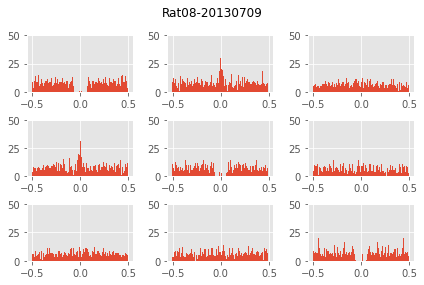

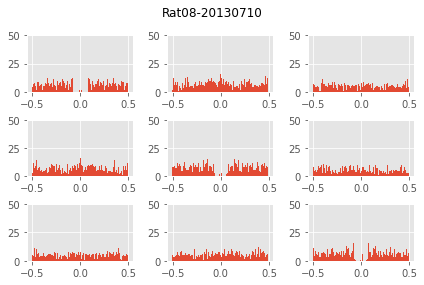

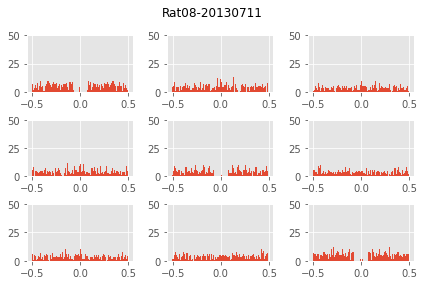

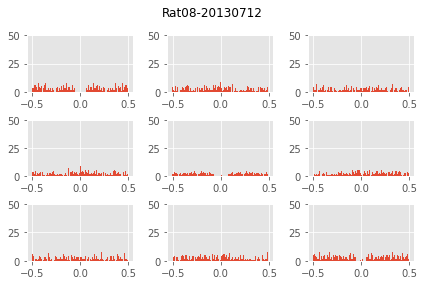

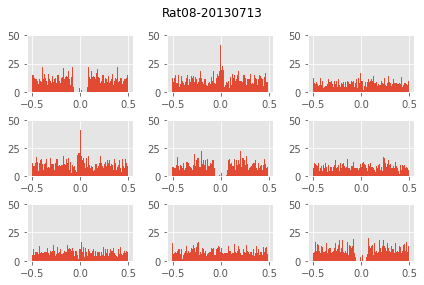

...

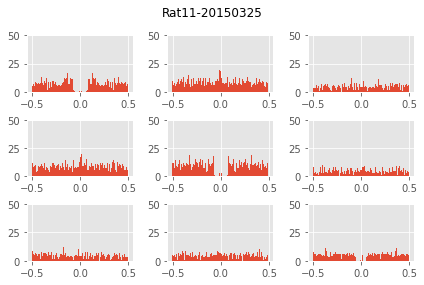

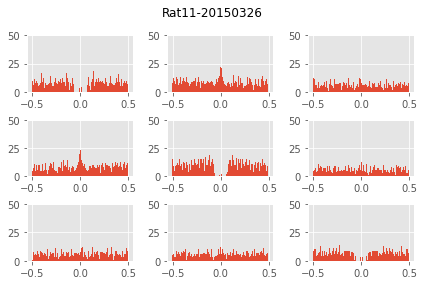

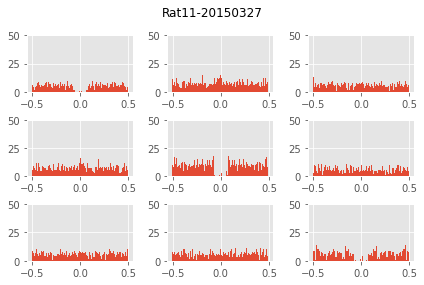

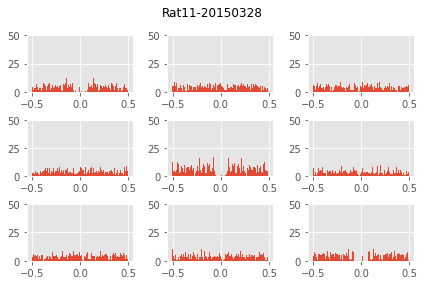

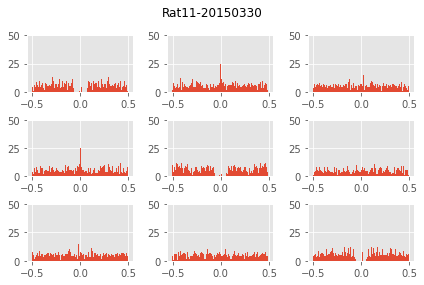

In [12]:
bk.load.batch(plot_all_cross_corr)